# Using ResNet50 image predictions
### Adapted from https://www.kaggle.com/dansbecker/programming-in-tensorflow-and-keras

In [12]:
import os
from os.path import join
import sys

from IPython.display import Image, display

In [4]:
image_dir = '../data/raw/train/'

img_paths = [join(image_dir, filename) for filename in 
                           ['0246f44bb123ce3f91c939861eb97fb7.jpg',
                            '84728e78632c0910a69d33f82e62638c.jpg',
                            '8825e914555803f4c67b26593c9d5aff.jpg',
                            '91a5e8db15bccfb6cfa2df5e8b95ec03.jpg']]

In [16]:
image_dir = '../data/raw/zane/'
img_paths = [join(image_dir, filename) for filename in os.listdir(image_dir)]
img_paths

['../data/raw/zane/crossed arms.jpg',
 '../data/raw/zane/Emma Watson.jpg',
 '../data/raw/zane/firefox_doge.png',
 '../data/raw/zane/IMG_5294.JPG',
 '../data/raw/zane/IMG_5504.JPG',
 '../data/raw/zane/IMG_5922.JPG',
 '../data/raw/zane/IMG_5973.JPG',
 '../data/raw/zane/IMG_6281.jpeg',
 '../data/raw/zane/IMG_6356.jpeg',
 '../data/raw/zane/IMG_6487 (1).jpg',
 '../data/raw/zane/IMG_6915.JPG',
 '../data/raw/zane/IMG_7124.JPG',
 '../data/raw/zane/IMG_8219.JPG',
 '../data/raw/zane/IMG_8531.JPG',
 '../data/raw/zane/IMG_8563.JPG',
 '../data/raw/zane/IMG_8606.JPG',
 '../data/raw/zane/IMG_9217.JPG']

In [7]:
import numpy as np
from tensorflow.python.keras.applications.resnet50 import preprocess_input
from tensorflow.python.keras.preprocessing.image import load_img, img_to_array

image_size = 224

def read_and_prep_images(img_paths, img_height=image_size, img_width=image_size):
    imgs = [load_img(img_path, target_size=(img_height, img_width)) for img_path in img_paths]
    img_array = np.array([img_to_array(img) for img in imgs])
    return preprocess_input(img_array)

In [18]:
from tensorflow.python.keras.applications import ResNet50

my_model = ResNet50(weights='../models/resnet50/resnet50_weights_tf_dim_ordering_tf_kernels.h5')
test_data = read_and_prep_images(img_paths)
preds = my_model.predict(test_data)

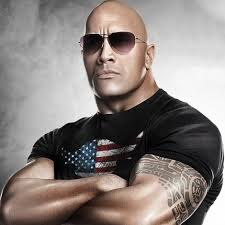

[('n04356056', 'sunglasses', 0.78343004), ('n04355933', 'sunglass', 0.18064779), ('n02672831', 'accordion', 0.0054047722)]


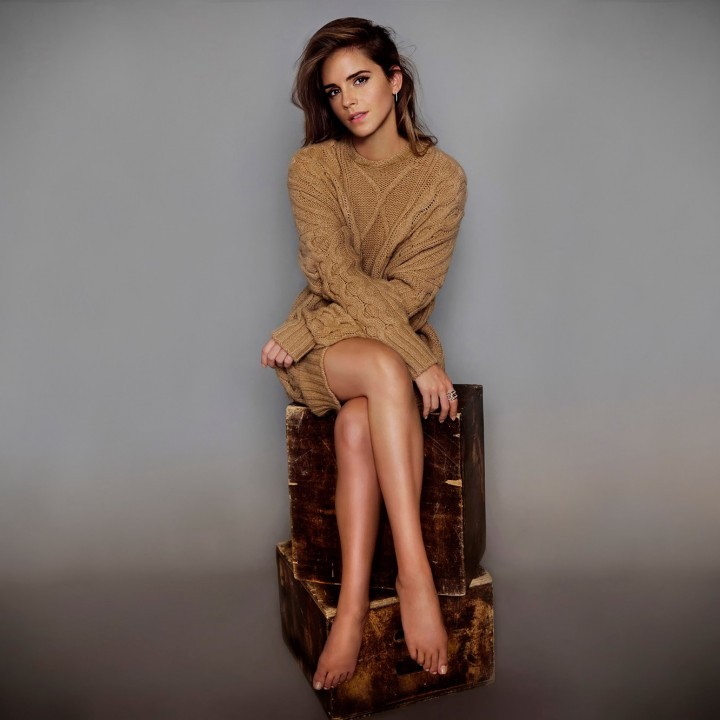

[('n03404251', 'fur_coat', 0.85577196), ('n03045698', 'cloak', 0.041175887), ('n03450230', 'gown', 0.027910516)]


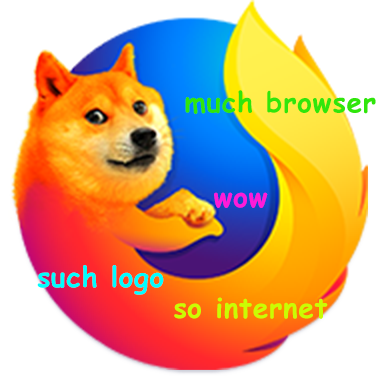

[('n02948072', 'candle', 0.07486353), ('n07747607', 'orange', 0.07317508), ('n04404412', 'television', 0.06819689)]


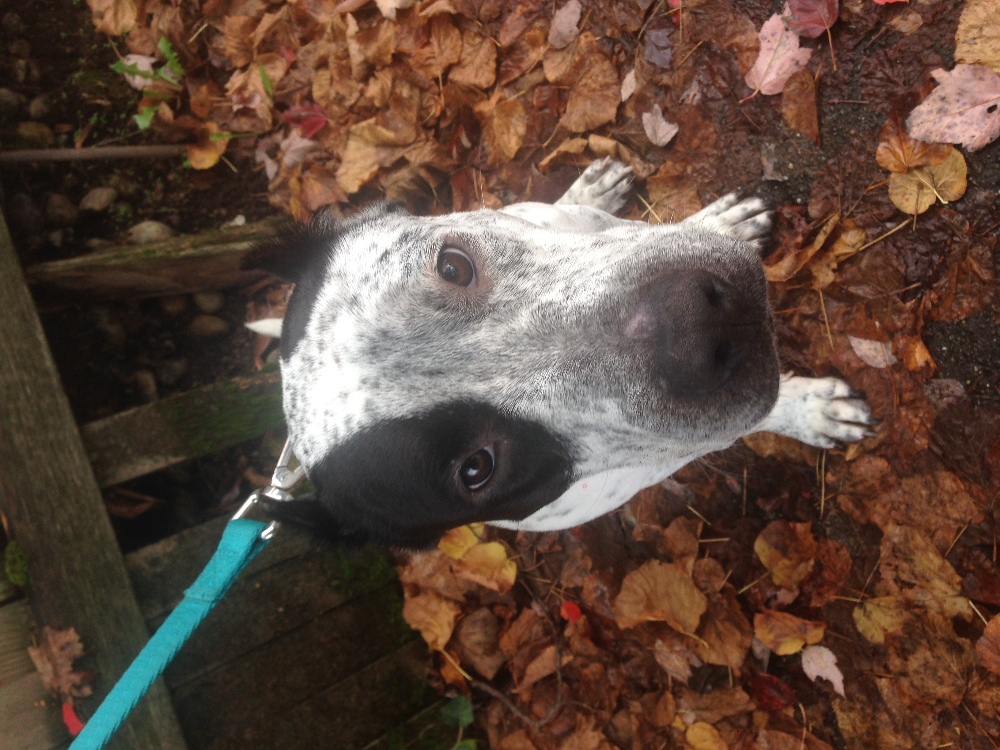

[('n01882714', 'koala', 0.41160682), ('n02088632', 'bluetick', 0.11438588), ('n02655020', 'puffer', 0.079117335)]


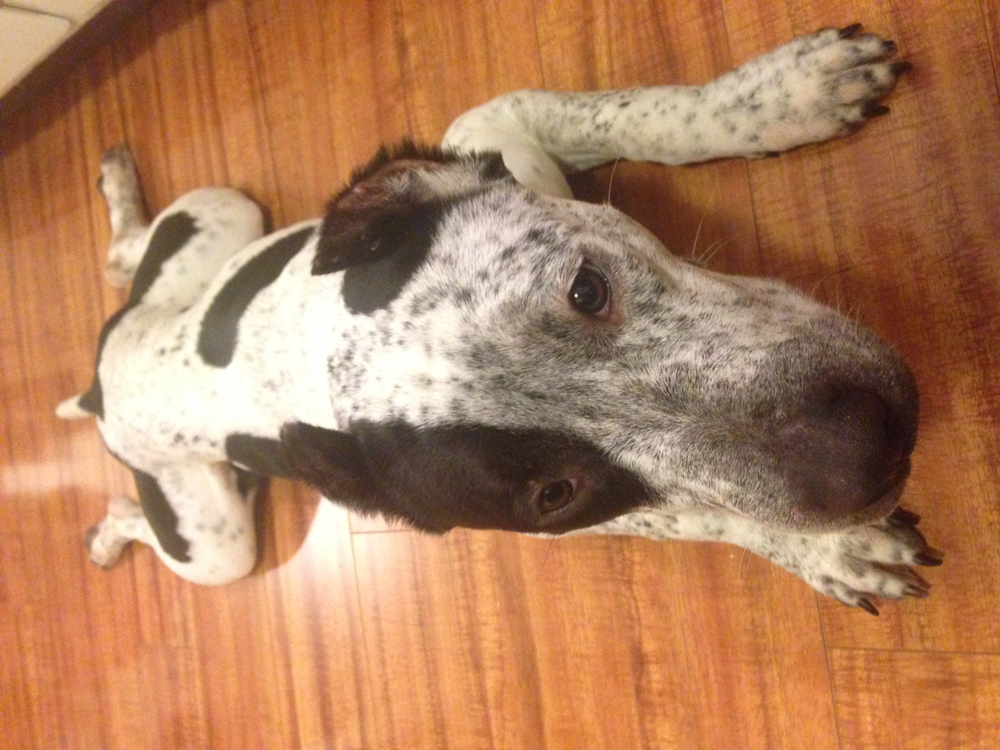

[('n02088632', 'bluetick', 0.89602554), ('n02100236', 'German_short-haired_pointer', 0.05757872), ('n02088238', 'basset', 0.011939757)]


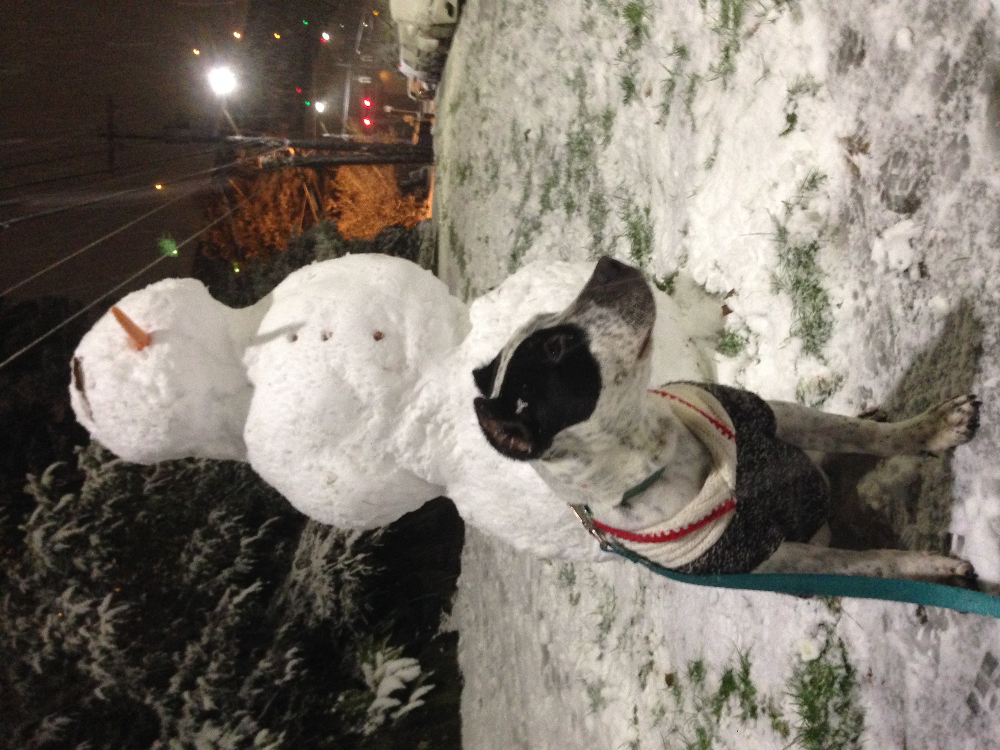

[('n09246464', 'cliff', 0.4314591), ('n02100236', 'German_short-haired_pointer', 0.26879758), ('n04399382', 'teddy', 0.076086424)]


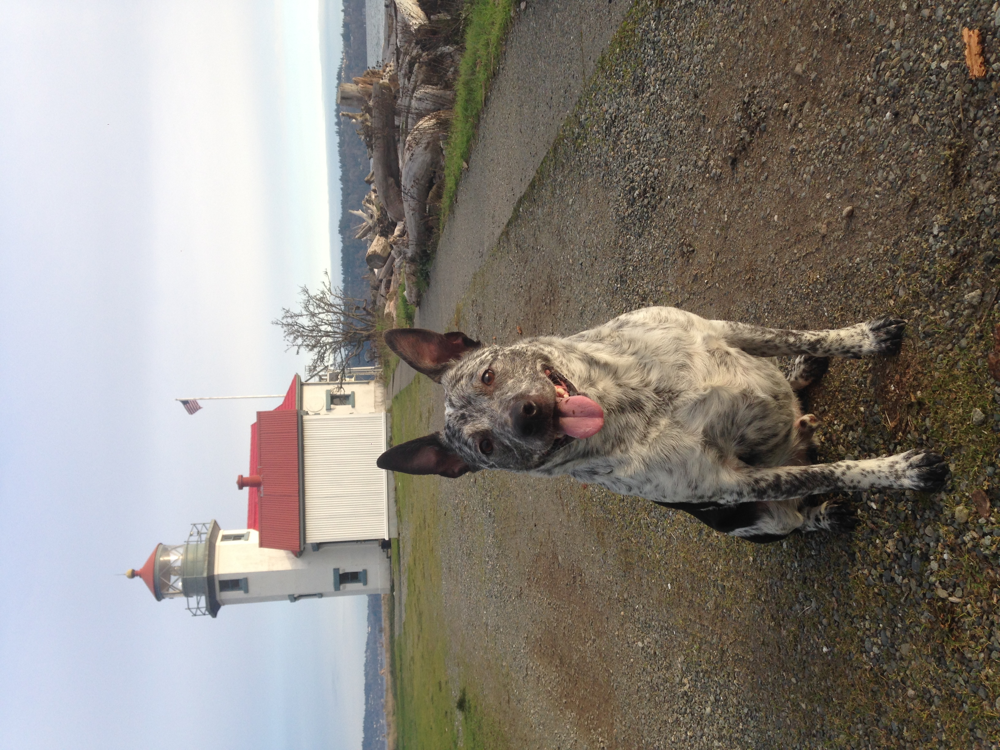

[('n02090721', 'Irish_wolfhound', 0.0824686), ('n02096177', 'cairn', 0.07907489), ('n02105162', 'malinois', 0.07673332)]


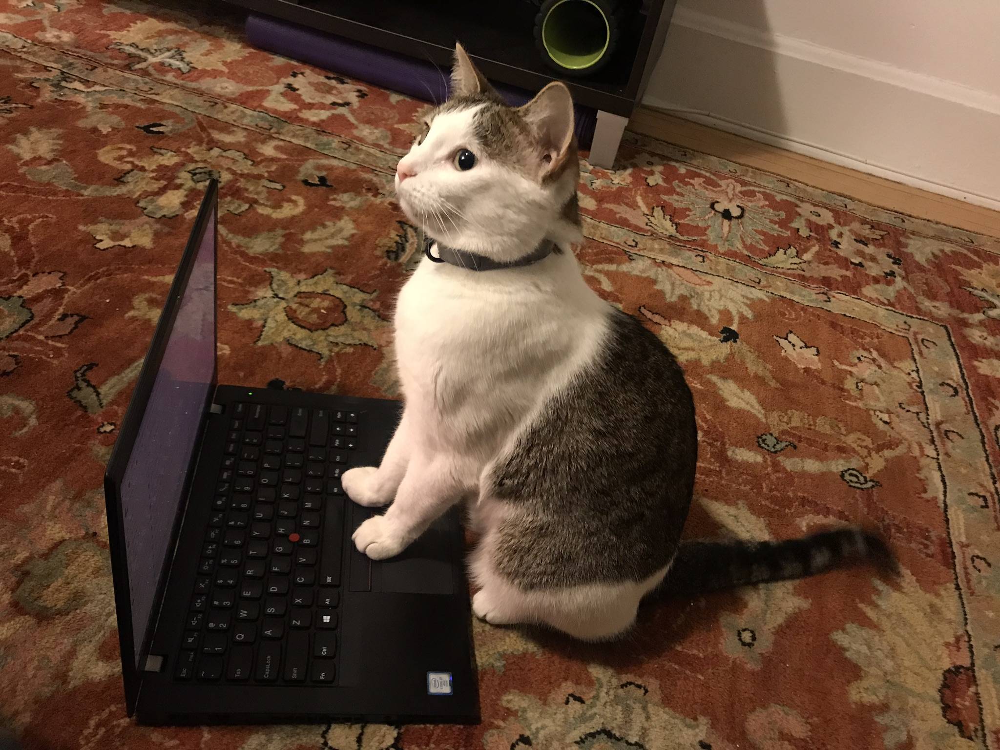

[('n02123597', 'Siamese_cat', 0.3714663), ('n01877812', 'wallaby', 0.18215925), ('n02124075', 'Egyptian_cat', 0.10944173)]


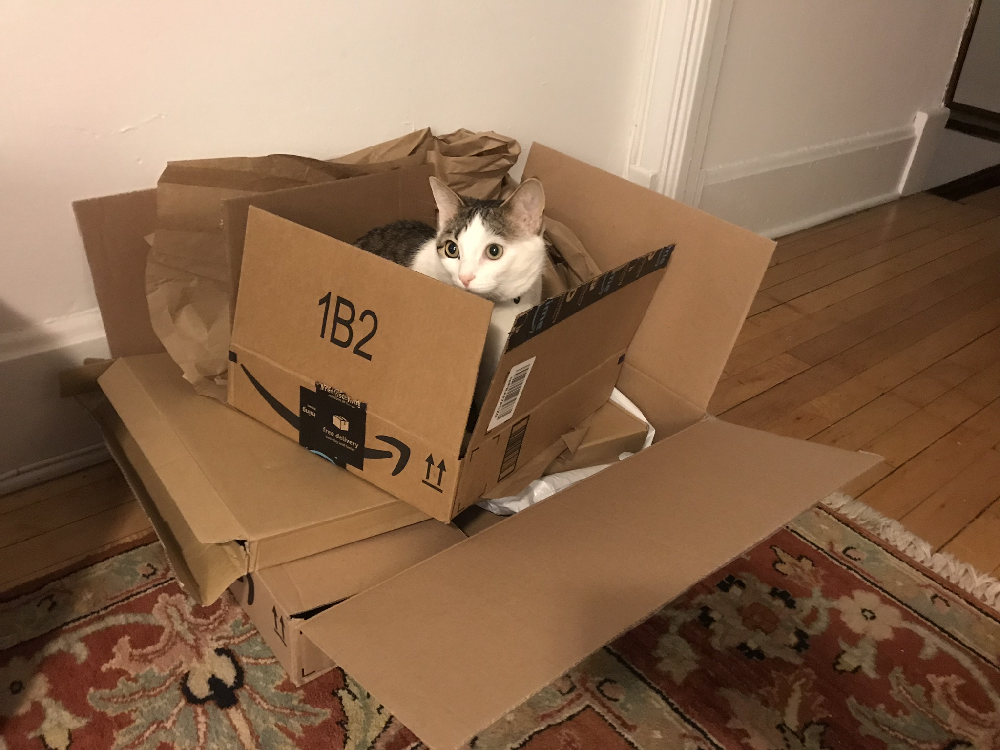

[('n02971356', 'carton', 0.9627901), ('n03127925', 'crate', 0.008696482), ('n03014705', 'chest', 0.0032180268)]


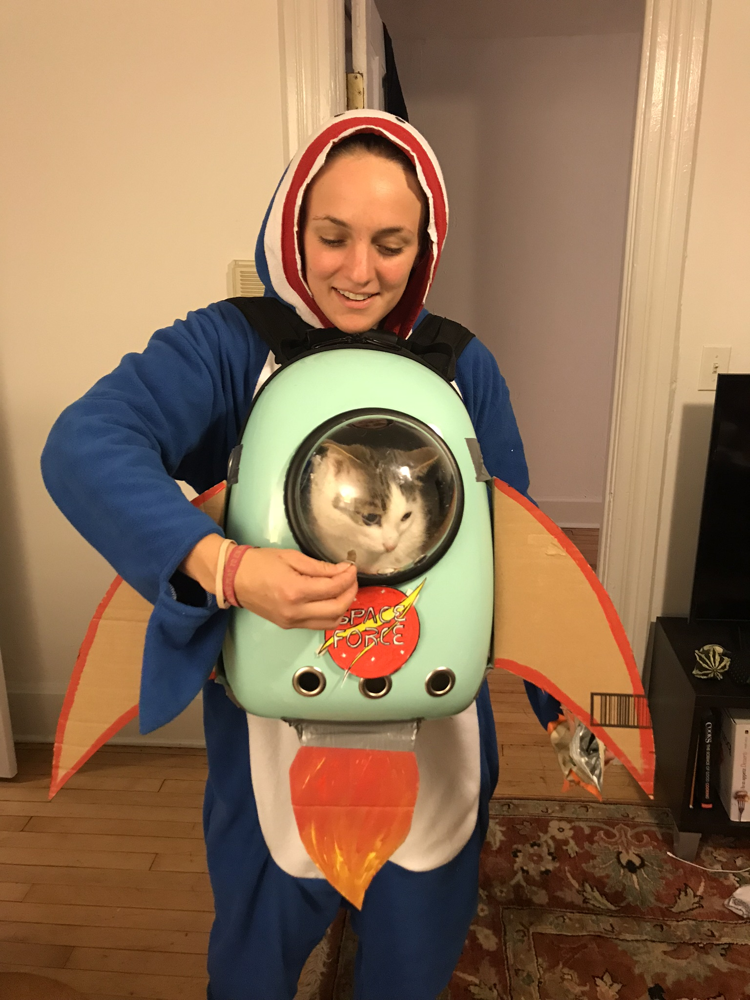

[('n04447861', 'toilet_seat', 0.9803791), ('n03133878', 'Crock_Pot', 0.0044530123), ('n03249569', 'drum', 0.0042789783)]


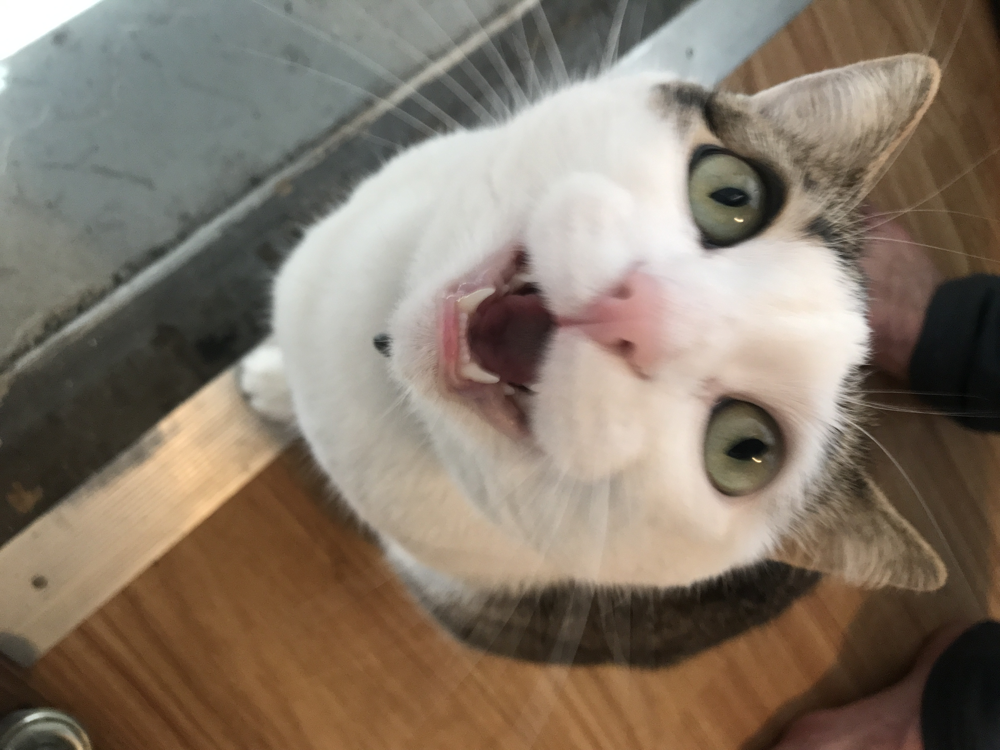

[('n02123597', 'Siamese_cat', 0.30856934), ('n03223299', 'doormat', 0.12218309), ('n02123045', 'tabby', 0.05065085)]


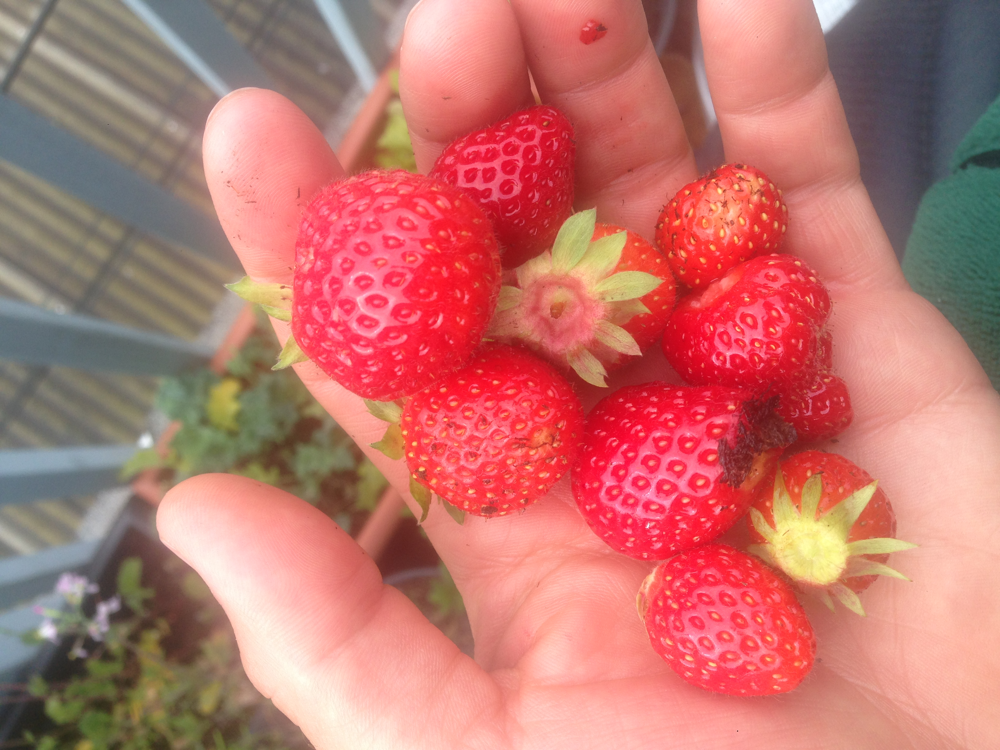

[('n07745940', 'strawberry', 0.8348673), ('n01833805', 'hummingbird', 0.024416517), ('n03814906', 'necklace', 0.02364511)]


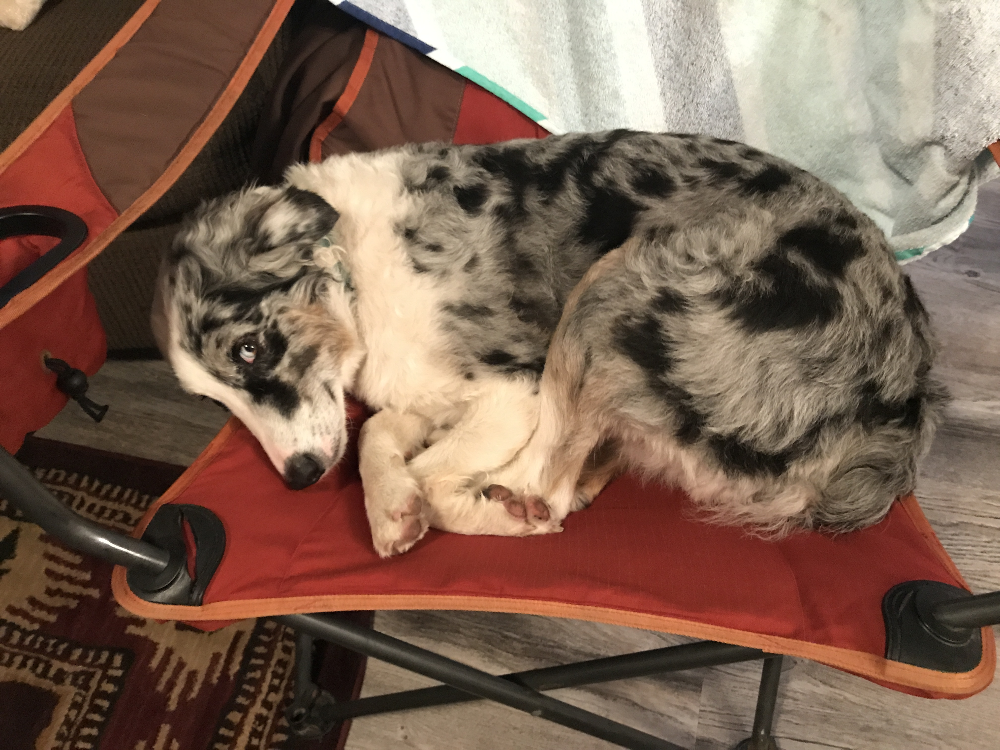

[('n02113186', 'Cardigan', 0.79178596), ('n02128757', 'snow_leopard', 0.048465453), ('n02124075', 'Egyptian_cat', 0.026703972)]


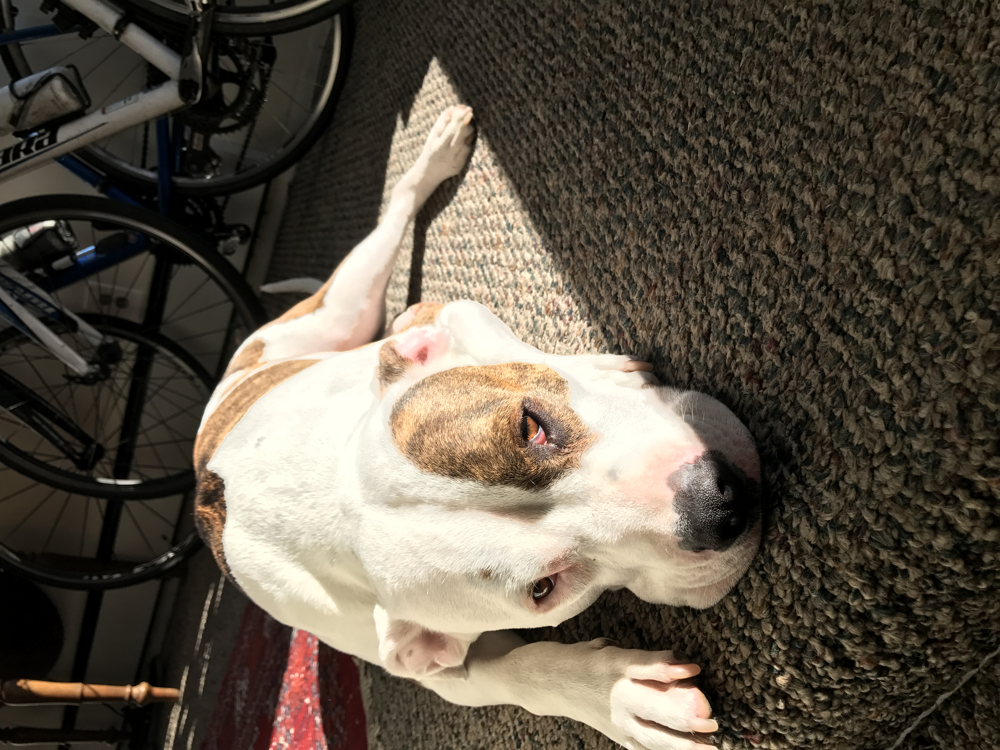

[('n02108915', 'French_bulldog', 0.57858306), ('n02096585', 'Boston_bull', 0.1004451), ('n02093428', 'American_Staffordshire_terrier', 0.06967283)]


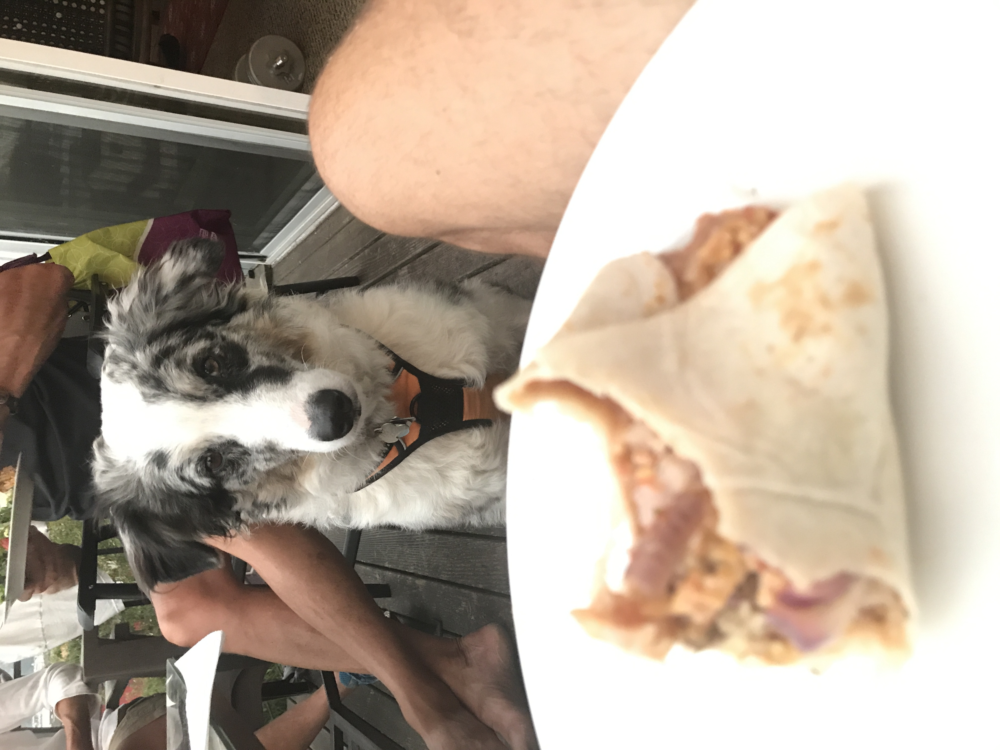

[('n07880968', 'burrito', 0.15480812), ('n03887697', 'paper_towel', 0.11570043), ('n01882714', 'koala', 0.05808148)]


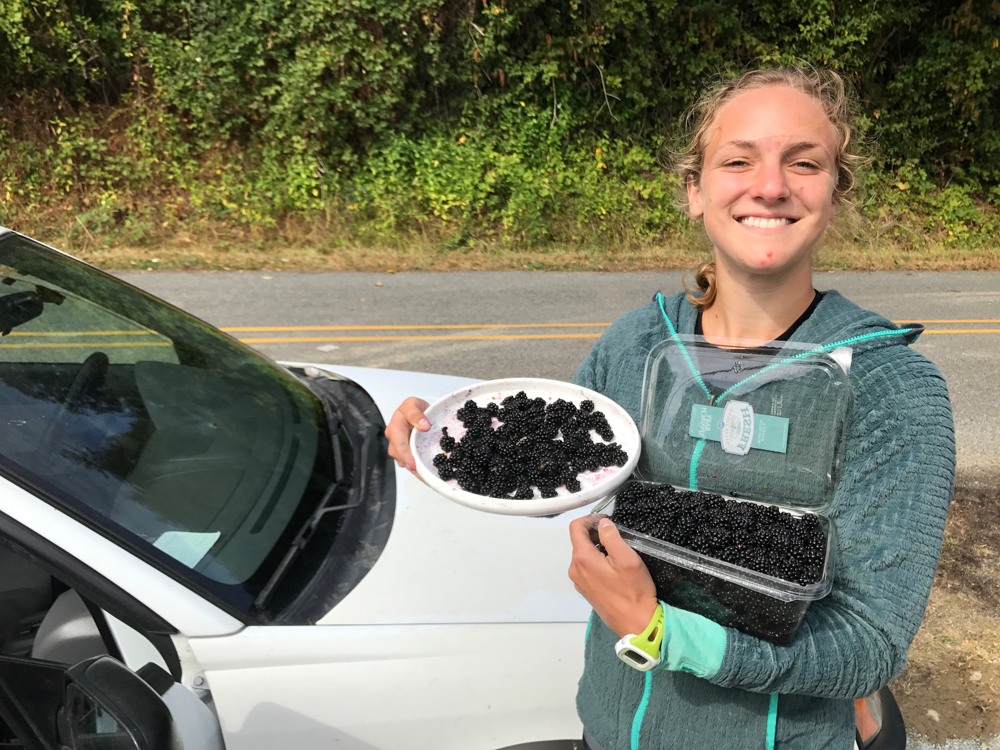

[('n03445924', 'golfcart', 0.4181305), ('n03770679', 'minivan', 0.054600194), ('n02110341', 'dalmatian', 0.03330727)]


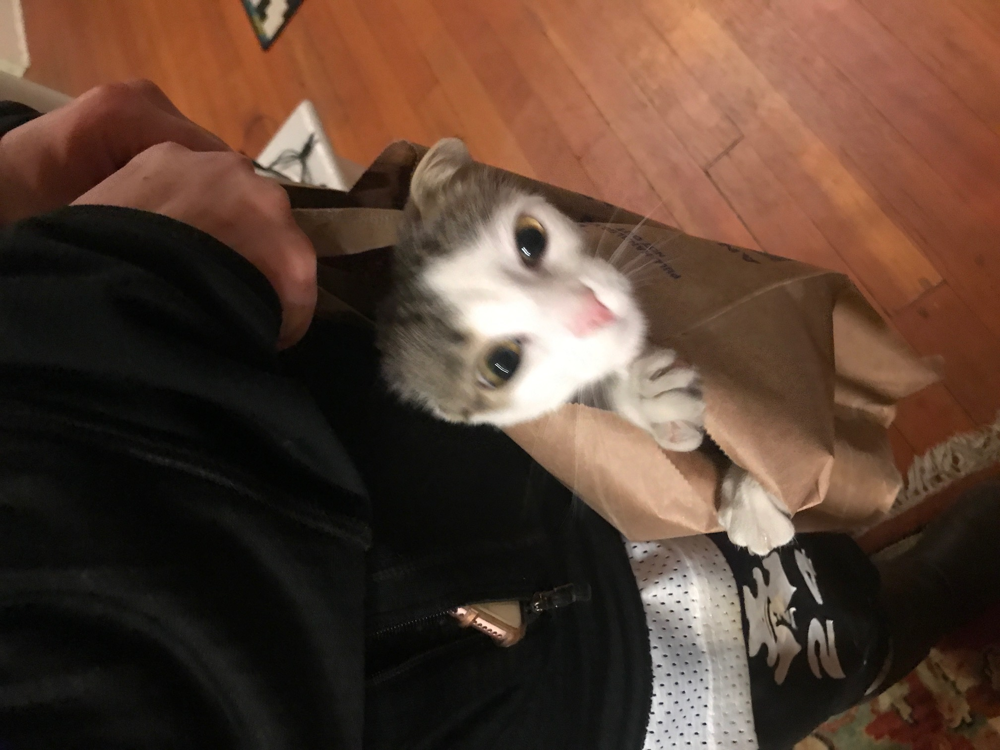

[('n02443484', 'black-footed_ferret', 0.44843245), ('n02342885', 'hamster', 0.07562579), ('n02110185', 'Siberian_husky', 0.060500287)]


In [19]:
from src.utils.decode_predictions import decode_predictions

most_likely_labels = decode_predictions(preds, top=3, class_list_path='../models/resnet50/imagenet_class_index.json')

for i, img_path in enumerate(img_paths):
    display(Image(img_path))
    print(most_likely_labels[i])